### Mount Drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Import necessary libraries

In [2]:
!pip3 install opencv-python
from google.colab.patches import cv2_imshow
from sklearn.ensemble import IsolationForest
from matplotlib import pyplot as plt
import numpy as np
import cv2
import os

### Introduction to Dataset

> Training Images: 620 Images of trees and forest.


> Test Images: 280 images of forest fire and few forest images 

Training Image - Forest Image


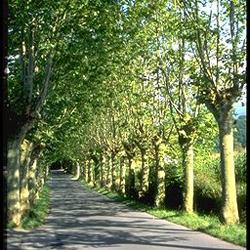

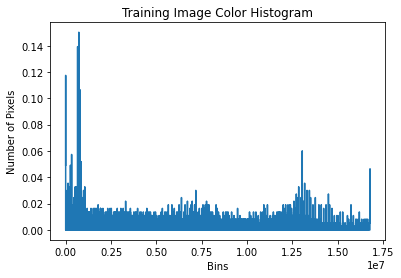

Test Image - Forest Image with fire (Anomaly)


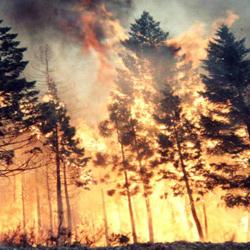

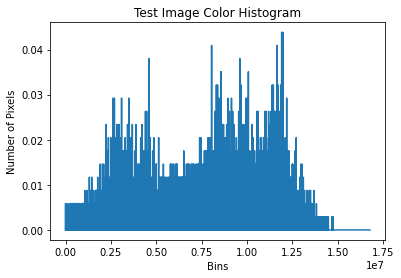

In [3]:
# Let us look into a training image and the color distribution over it
training_img = cv2.imread('/content/drive/MyDrive/Forest_fire/forest/nofire_0111.jpg')
hist = cv2.calcHist([training_img], [0, 1, 2], None, [256, 256, 256], [0, 256, 0, 256, 0, 256])
hist = cv2.normalize(hist, hist).flatten()
plt.plot(hist)
plt.title("Training Image Color Histogram")
plt.xlabel("Bins")
plt.ylabel("Number of Pixels")
print('Training Image - Forest Image')
cv2_imshow(training_img)
plt.show()

# Let us look into a test image and the color distribution over it
test_img = cv2.imread('/content/drive/MyDrive/Forest_fire/test/fire_0025.jpg')
hist = cv2.calcHist([test_img], [0, 1, 2], None, [256, 256, 256], [0, 256, 0, 256, 0, 256])
hist = cv2.normalize(hist, hist).flatten()
plt.plot(hist)
plt.title("Test Image Color Histogram")
plt.xlabel("Bins")
plt.ylabel("Number of Pixels")
print('Test Image - Forest Image with fire (Anomaly)')
cv2_imshow(test_img)
plt.show()

### Define Feature extractor

> Color Histograms are a graphical representation of a distribution of colors within an image. The data contained in a histogram is obtained by counting the occurrence of each possible color of the respective color model within the image.

In [4]:
# Let us compute 3D color(RGB) histogram of our images which we will use as a feature to train our model
def feature_extraction(image):
  hist = cv2.calcHist([image], [0, 1, 2], None, [4, 6, 3], [0, 256, 0, 256, 0, 256])
  hist = cv2.normalize(hist, hist).flatten()
  return hist

### Prepare Dataset for training

In [5]:
dataset = []
imagePaths = []
datasetPath = '/content/drive/MyDrive/Forest_fire/forest/'
for imagePaths in os.listdir(datasetPath):
  image = cv2.imread(os.path.join(datasetPath,imagePaths))
  features = feature_extraction(image)
  dataset.append(features)
  
data = np.array(dataset)

### Isolation Forest Model

In [6]:
model = IsolationForest(contamination=0.01)
model.fit(data)

IsolationForest(contamination=0.01)

### Model Prediction

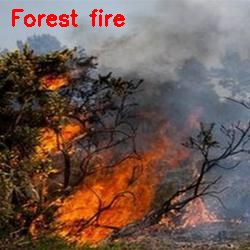

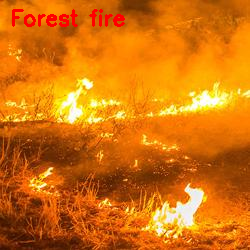

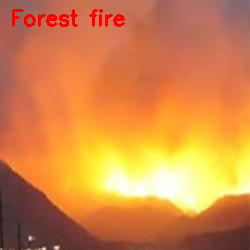

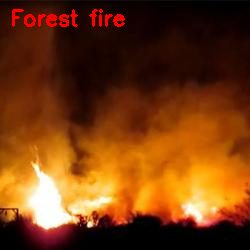

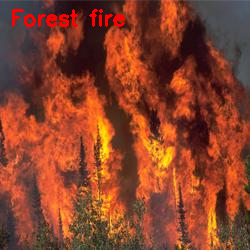

...

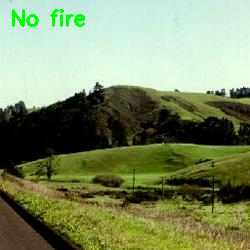

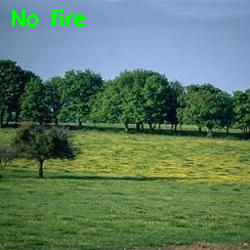

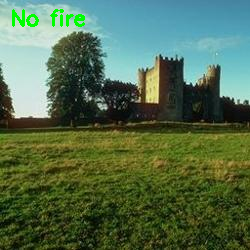

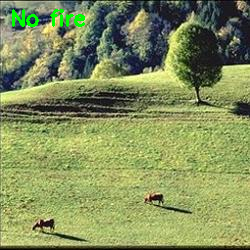

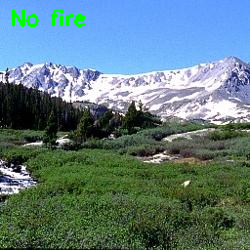

In [7]:
testimages = []
testfolder = '/content/drive/MyDrive/Forest_fire/test/'
for testimage_path in os.listdir(testfolder):
  image = cv2.imread(os.path.join(testfolder,testimage_path))
  features = feature_extraction(image)
  preds = model.predict([features])[0]
  label = "Forest fire" if preds == -1 else "No fire"
  color = (0, 0, 255) if preds == -1 else (0, 255, 0)
  cv2.putText(image, label, (10,  25), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)
  cv2_imshow(image)
